In [1]:
from scipy import ndimage
import matplotlib.pyplot as plt
import numpy as np
import os
from scipy import misc
from sklearn.cluster import KMeans
import seaborn as sns
from numpy import linalg as la
from math import floor
import scipy.stats as st
from ipywidgets import interact, interactive, fixed, interact_manual
from ipywidgets import IntSlider
import json
import cv2

detector = cv2.CascadeClassifier(f'/Users/jeroaranda/anaconda3/lib/python3.7/site-packages/cv2/data/haarcascade_frontalface_default.xml')
def roundup(number):
    return round(number+.5)

#### Load JSON

In [2]:
with open('personasdesaparecidas.json','r',encoding='utf8') as f:
    datastore=json.load(f)

# Mostrar las imágenes

/Users/jeroaranda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:7: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
  import sys
/Users/jeroaranda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:9: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
  if __name__ == '__main__':


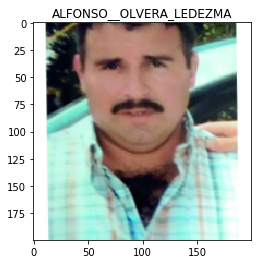

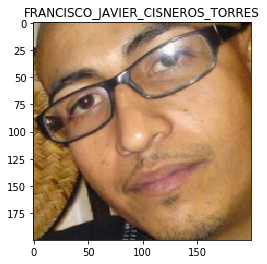

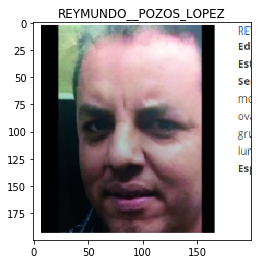

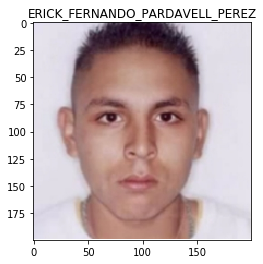

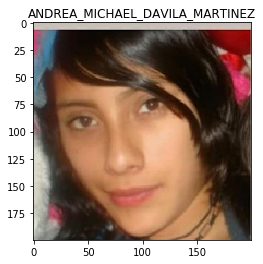

...

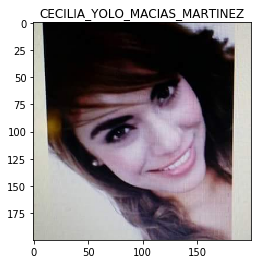

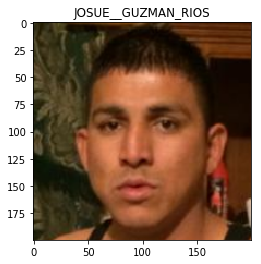

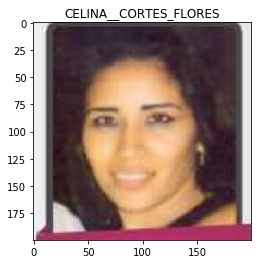

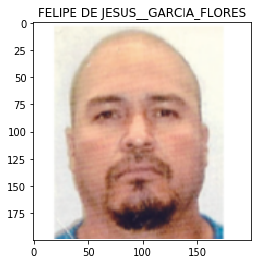

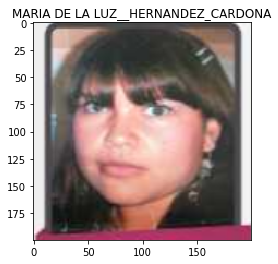

In [9]:
a=os.listdir('Imagenes')
df=[]
i=0
for file in a:
    if os.path.isdir(f'Imagenes/{file}'):
        try:
            img=misc.imread(f'Imagenes/{file}/{file}.jpg')
        except:
            img=misc.imread(f'Imagenes/{file}/{file}.png')
        plt.figure()
        plt.title(file)
        plt.imshow(img)
        i+=1

# Crear imagen panóramica a partir de todos los recuadros

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34


/Users/jeroaranda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:14: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
  


35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154


/Users/jeroaranda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:16: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
  app.launch_new_instance()


155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
277
278
279
280
281
282
283
284
285
286
287
288
289
290
291
292
293
294
295
296
297
298
299
300
301
302
303
304
305
306
307
308
309
310
311
312
313
314
315
316
317
318
319
320
321
322
323
324
325
326
327
328
329
330
331
332
333
334
335
336
337
338
339
340
341
342
343
344
345
346
347
348
349
350
351
352
353
354
355
356
357
358
359
360
361
362
363
364
365
366
367
368
369
370
371
372
373
374
375
376
377
378
379
380
381
382
383
384
385
386
387
388
389
390
391
392
393
394
395
396
397
398
399
400
401
402
403
404


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
/Users/jeroaranda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:20: DeprecationWarning: `imsave` is deprecated!
`imsave` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imwrite`` instead.


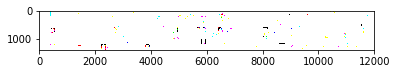

In [53]:
a=os.listdir('Imagenes')
m=7
n=60
new_img=np.zeros((m*200,n*200,4))
a=os.listdir('Imagenes')

for i in range(m):
    for j in range(n):
        print(n*i+j)
        file=a[n*i+j]
        if os.path.isdir(f'Imagenes/{file}'): 
            slicer=(slice(200*i, 200*(i+1), 1), slice(200*j,200*(j+1), 1), slice(0, 4, 1))
            try:
                img=misc.imread(f'Imagenes/{file}/{file}.jpg')
            except:
                img=misc.imread(f'Imagenes/{file}/{file}.png')
            if img.shape==(200,200,4):
                new_img[slicer]=img
misc.imsave(f'panoramica.png', new_img) 

![alt text](panoramica.png "panoramica")

### Preparar imagen para ser visualizada en el oculus.
#### Panoramica:

In [69]:
img=misc.imread(f'panoramica.png')
dimensiones=((m+8)*200,n*200,4)
new_img_vr=np.zeros(dimensiones)
slicer=(slice(800,2200, 1), slice(0,n*200, 1), slice(0, 4, 1))
new_img_vr[slicer]=img

#slicer=(slice(200,400, 1), slice(28*200,29*200, 1), slice(0, 4, 1))
#new_img_vr[slicer]=misc.imread(f'mediana_mujer1.png')


#slicer=(slice(200,400, 1), slice(31*200,32*200, 1), slice(0, 4, 1))
#new_img_vr[slicer]=misc.imread(f'mediana_hombre1.png')

#new_img_vr[4]=1
misc.imsave(f'panoramica_vr.png', new_img_vr)

/Users/jeroaranda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
  """Entry point for launching an IPython kernel.
/Users/jeroaranda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: DeprecationWarning: `imsave` is deprecated!
`imsave` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imwrite`` instead.
  from ipykernel import kernelapp as app


# Panoramica padeada

![alt text](panoramica_vr.png "panoramica")

#### Caras medianas:

In [52]:
dimensiones=(200,600,4)
new_img_vr=np.zeros(dimensiones)
new_img_vr[0:200,0:200,0:4]=misc.imread(f'mediana_mujer1.png')
new_img_vr[0:200,400:600,0:4]=misc.imread(f'mediana_hombre1.png')
misc.imsave(f'medianas_vr.png', new_img_vr)

/Users/jeroaranda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
  This is separate from the ipykernel package so we can avoid doing imports until
/Users/jeroaranda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:4: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
  after removing the cwd from sys.path.
/Users/jeroaranda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: DeprecationWarning: `imsave` is deprecated!
`imsave` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imwrite`` instead.
  """


# Los desaparecidos:
![alt text](medianas_vr.png "medianas")

# panoramica padeada con caras promedio

In [31]:
img

array([[[255, 255, 255, 255],
        [255, 255, 255, 255],
        [255, 255, 255, 255],
        ...,
        [165, 175, 184, 255],
        [153, 166, 172, 255],
        [140, 154, 158, 255]],

       [[255, 255, 255, 255],
        [255, 255, 255, 255],
        [255, 255, 255, 255],
        ...,
        [163, 173, 182, 255],
        [152, 165, 171, 255],
        [141, 155, 159, 255]],

       [[255, 255, 255, 255],
        [255, 255, 255, 255],
        [255, 255, 255, 255],
        ...,
        [152, 162, 171, 255],
        [145, 158, 165, 255],
        [133, 147, 151, 255]],

       ...,

       [[ 25,  47,  82, 255],
        [ 26,  47,  83, 255],
        [ 29,  50,  86, 255],
        ...,
        [156,  58,  96, 255],
        [151,  62,  97, 255],
        [153,  72, 104, 255]],

       [[ 29,  49,  85, 255],
        [ 28,  48,  85, 255],
        [ 25,  45,  82, 255],
        ...,
        [154,  59,  96, 255],
        [150,  63,  97, 255],
        [152,  73, 104, 255]],

       [[ 30

In [35]:
m=7
n=60
face=misc.imread(f'mediana_mujer1.png')
crop_face1 = misc.imresize(face,(600,600,4))
face=misc.imread(f'mediana_hombre1.png')
crop_face2 = misc.imresize(face,(600,600,4))
img=misc.imread(f'panoramica.png')
dimensiones=((m+8)*200,n*200,4)
new_img_vr=np.zeros(dimensiones)
slicer=(slice(800,2200, 1), slice(0,n*200, 1), slice(0, 4, 1))
new_img_vr[slicer]=img
#Añade marco.
for i in range(m):
    new_img_vr[(i+4)*200-10:(i+4)*200+10,:,:]=np.array([0,0,0,1])
for i in range(n):
    new_img_vr[:,(i)*200-10:(i)*200+10,:]=np.array([1,1,1,1])
#Añade las imagenes centrales.
new_img_vr[6*200-10:9*200+10,26*200-10:29*200+10,0:4]=np.array([255,255,255,255])


new_img_vr[6*200-10:9*200+10,31*200-10:34*200+10,0:4]=np.array([255,255,255,255])

new_img_vr[6*200:9*200,26*200:29*200,0:4]=crop_face1


new_img_vr[6*200:9*200,31*200:34*200,0:4]=crop_face2

#new_img_vr[4]=1
misc.imsave(f'panoramica2_vr.png', new_img_vr)

/Users/jeroaranda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
  This is separate from the ipykernel package so we can avoid doing imports until
/Users/jeroaranda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:4: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``skimage.transform.resize`` instead.
  after removing the cwd from sys.path.
/Users/jeroaranda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
  """
/Users/jeroaranda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be 

# Los desaparecidos:
![alt text](panoramica2_vr.png "medianas")

# Obtener imagen promedio

Se calcula el promedio de todas las imágenes.

In [33]:
a=os.listdir('Imagenes')
new_img=np.zeros((200,200,4))
for file in a:
    if os.path.isdir(f'Imagenes/{file}'):
        try:
            new_img=new_img+misc.imread(f'Imagenes/{file}/{file}.jpg')
        except:
            new_img=new_img+misc.imread(f'Imagenes/{file}/{file}.png')
new_img=new_img/452
misc.imsave(f'imagen_promedio.png', new_img) 

/Users/jeroaranda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
  
/Users/jeroaranda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:8: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
  
/Users/jeroaranda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:10: DeprecationWarning: `imsave` is deprecated!
`imsave` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imwrite`` instead.
  # Remove the CWD from sys.path while we load stuff.


![alt text](imagen_promedio.png "Imagen promedio")

# Separar en hombres y mujeres (promedio)

In [14]:
new_img_mujer=np.zeros((200,200,4))
new_img_hombre=np.zeros((200,200,4))
m=0
h=0
for persona in datastore:
    file=f"{persona['versiones'][0]['prim_nombre']}_{persona['versiones'][0]['seg_nombre']}_{persona['versiones'][0]['apellido_pat']}_{persona['versiones'][0]['apellido_mat']}"
    if os.path.isdir(f'Imagenes/{file}'):
        if persona['versiones'][0]['fuerocomun_sexo'] =='HOMBRE':
            try:
                new_img_hombre=new_img_hombre+misc.imread(f'Imagenes/{file}/{file}.jpg')
            except:
                new_img_hombre=new_img_hombre+misc.imread(f'Imagenes/{file}/{file}.png')
            h+=1
        elif persona['versiones'][0]['fuerocomun_sexo'] == 'MUJER':
            try:
                new_img_mujer=new_img_mujer+misc.imread(f'Imagenes/{file}/{file}.jpg')
            except:
                new_img_mujer=new_img_mujer+misc.imread(f'Imagenes/{file}/{file}.png')
            m+=1
new_img_mujeres=new_img_mujer/m
new_img_hombres=new_img_hombre/h
misc.imsave(f'promedio_mujer.png', new_img_mujeres) 
misc.imsave(f'promedio_hombre.png', new_img_hombres) 
print(h,m)

/Users/jeroaranda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:16: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
  app.launch_new_instance()
/Users/jeroaranda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:18: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
/Users/jeroaranda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:10: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
  # Remove the CWD from sys.path while we load stuff.
/Users/jeroaranda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:12: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
  if sys.p

217 203


/Users/jeroaranda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:22: DeprecationWarning: `imsave` is deprecated!
`imsave` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imwrite`` instead.
/Users/jeroaranda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:23: DeprecationWarning: `imsave` is deprecated!
`imsave` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imwrite`` instead.


### La mujer desaparecida
![alt text](promedio_mujer.png "Mujer")

### El hombre desaparecido
![alt text](promedio_hombre.png "Hombre")

# Separar en hombres y mujeres (mediana)
### cargar imagenes de hombres y mujeres

In [4]:
m=[]
h=[]
for persona in datastore:
    file=f"{persona['versiones'][0]['prim_nombre']}_{persona['versiones'][0]['seg_nombre']}_{persona['versiones'][0]['apellido_pat']}_{persona['versiones'][0]['apellido_mat']}"
    if os.path.isdir(f'Imagenes/{file}'):
        if persona['versiones'][0]['fuerocomun_sexo'] =='HOMBRE':
            try:
                new_img=misc.imread(f'Imagenes/{file}/{file}.jpg')
            except:
                new_img=misc.imread(f'Imagenes/{file}/{file}.png')
            h.append(new_img)
        elif persona['versiones'][0]['fuerocomun_sexo'] == 'MUJER':
            try:
                new_img=misc.imread(f'Imagenes/{file}/{file}.jpg')
            except:
                new_img=misc.imread(f'Imagenes/{file}/{file}.png')
            m.append(new_img)
m_arr=np.array(m)
h_arr=np.array(h)

/Users/jeroaranda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:14: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
  
/Users/jeroaranda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:16: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
  app.launch_new_instance()
/Users/jeroaranda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:8: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
  
/Users/jeroaranda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:10: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
  # Remove the CWD from sys.path while we load stuff.


### Encontrar medianas

In [14]:
new_img_mujeres=np.median(np.array(m_arr),axis=0)
new_img_hombres=np.median(np.array(h_arr),axis=0)
misc.imsave(f'mediana_mujer1.png', new_img_mujeres) 
misc.imsave(f'mediana_hombre1.png', new_img_hombres) 

/Users/jeroaranda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: DeprecationWarning: `imsave` is deprecated!
`imsave` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imwrite`` instead.
  This is separate from the ipykernel package so we can avoid doing imports until
/Users/jeroaranda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:4: DeprecationWarning: `imsave` is deprecated!
`imsave` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imwrite`` instead.
  after removing the cwd from sys.path.


### La mujer desaparecida
![alt text](mediana_mujer1.png "Mujer")


### El hombre desaparecido
![alt text](mediana_hombre1.png "Hombre")

In [65]:
i=0
m_limpias=[]
h_limpias=[]
for idx,mujer in enumerate(m_arr):
    gray = cv2.cvtColor(mujer, cv2.COLOR_BGR2GRAY)
    # detect faces in the grayscale frame
    rects = detector.detectMultiScale(gray, scaleFactor=1.1,
        minNeighbors=5, minSize=(30, 30),
        flags=cv2.CASCADE_SCALE_IMAGE)

    boxes = [(y, x + w, y + h, x) for (x, y, w, h) in rects]
    if len(boxes)>0:
        boxes = [(int(boxes[0][0]),int(boxes[0][1]),int(boxes[0][2]),int(boxes[0][3]))]
        m_limpias.append(mujer)
    else:
        i+=1
        plt.figure()
        plt.imshow(mujer)
print(i)
for idx,hombre in enumerate(h_arr):
    gray = cv2.cvtColor(hombre, cv2.COLOR_BGR2GRAY)
    # detect faces in the grayscale frame
    rects = detector.detectMultiScale(gray, scaleFactor=1.1,
        minNeighbors=5, minSize=(30, 30),
        flags=cv2.CASCADE_SCALE_IMAGE)

    boxes = [(y, x + w, y + h, x) for (x, y, w, h) in rects]
    if len(boxes)>0:
        boxes = [(int(boxes[0][0]),int(boxes[0][1]),int(boxes[0][2]),int(boxes[0][3]))]
        h_limpias.append(hombre)
    else:
        i+=1
        plt.figure()
        plt.imshow(hombre)
print(i)
m=np.array(m_limpias)
h=np.array(h_limpias)
new_img_mujeres=np.median(np.array(m),axis=0)
new_img_hombres=np.median(np.array(h),axis=0)
misc.imsave(f'mediana_mujer.png', new_img_mujeres) 
misc.imsave(f'mediana_hombre.png', new_img_hombres) 

/Users/jeroaranda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: DeprecationWarning: `imsave` is deprecated!
`imsave` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imwrite`` instead.
  """
/Users/jeroaranda/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: DeprecationWarning: `imsave` is deprecated!
`imsave` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imwrite`` instead.
  


### La mujer desaparecida
![alt text](mediana_mujer.png "Mujer")


### El hombre desaparecido
![alt text](mediana_hombre.png "Hombre")

# Alinear caras 

In [68]:
i=0
m_limpias=[]

for idx,mujer in enumerate(m_arr):
    gray = cv2.cvtColor(mujer, cv2.COLOR_BGR2GRAY)
    # detect faces in the grayscale frame
    rects = detector.detectMultiScale(gray, scaleFactor=1.1,
        minNeighbors=5, minSize=(30, 30),
        flags=cv2.CASCADE_SCALE_IMAGE)

    boxes = [(y, x + w, y + h, x) for (x, y, w, h) in rects]
    for (x, y, w, h) in rects:
        print(h,w)


89 89
135 135
127 127
121 121
112 112
113 113
154 154
136 136
137 137
109 109
132 132
94 94
109 109
147 147
112 112
159 159
142 142
120 120
138 138
137 137
142 142
144 144
167 167
102 102
111 111
117 117
135 135
156 156
148 148
95 95
116 116
72 72
85 85
114 114
96 96
157 157
162 162
123 123
153 153
106 106
132 132
123 123
72 72
107 107
87 87
160 160
114 114
135 135
108 108
152 152
112 112
130 130
133 133
93 93
115 115
104 104
99 99
161 161
134 134
119 119
59 59
129 129
122 122
118 118
114 114
152 152
158 158
124 124
108 108
129 129
101 101
109 109
122 122
106 106
165 165
166 166
105 105
160 160
132 132
141 141
123 123
82 82
114 114
108 108
126 126
76 76
112 112
141 141
131 131
106 106
133 133
125 125
132 132
106 106
129 129
122 122
142 142
100 100
82 82
142 142
159 159
123 123
97 97
103 103
149 149
169 169
110 110
107 107
112 112
112 112
138 138
94 94
74 74
68 68
85 85
119 119
120 120
146 146
120 120
158 158
164 164
110 110
167 167
65 65
131 131
148 148
115 115
59 59
155 155
149 149
12

In [ ]:
h_limpias=[]
i=0
for idx,hombre in enumerate(h_arr):
    gray = cv2.cvtColor(hombre, cv2.COLOR_BGR2GRAY)
    # detect faces in the grayscale frame
    rects = detector.detectMultiScale(gray, scaleFactor=1.1,
        minNeighbors=5, minSize=(30, 30),
        flags=cv2.CASCADE_SCALE_IMAGE)

    boxes = [(y, x + w, y + h, x) for (x, y, w, h) in rects]
    if len(boxes)>0:
        boxes = [(int(boxes[0][0]),int(boxes[0][1]),int(boxes[0][2]),int(boxes[0][3]))]
        h_limpias.append(hombre)
    else:
        i+=1
        plt.figure()
        plt.imshow(hombre)
print(i)